In [1]:
import util
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed
from sklearn.metrics import auc, mean_squared_error
from sklearn.preprocessing import normalize
from scipy.ndimage import gaussian_filter
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans
from operator import itemgetter
from celluloid import Camera
from tqdm import tqdm

import matplotlib
matplotlib.rc('font', size=8)

In [2]:
with open('dataset_5s.pkl', 'rb') as f:
    ds = pickle.load(f)
indices, segments, segments_wind, segments_location = ds['index'], ds['bunker'], ds['wind'], ds['location']

print('Number of data segments', len(indices))

Number of data segments 100


In [3]:
n_class = 100
# test_segment = 5
test_segment = 83

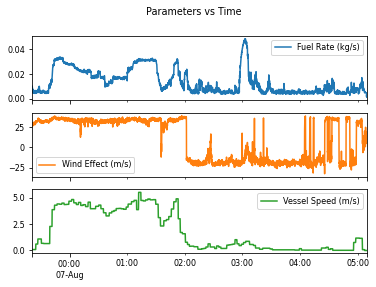

In [4]:
view = pd.concat([segments[test_segment].sum(axis=1), 
                  segments_wind[test_segment]['effect'], 
                  segments_location[test_segment]['distance']], 
                 axis=1)
view.columns = ['Fuel Rate (kg/s)', 'Wind Effect (m/s)', 'Vessel Speed (m/s)']
view.plot(subplots=True, title='Parameters vs Time');

In [5]:
%%time


# signals: input (in array), scores: output, estimators: TimeSeriesKMeans estimator
# each has three elements (bunker, wind, distance)

signals, scores, estimators = util.get_scores(segments, segments_wind, segments_location, 
                                              stride=3,             # 5s x 3    = 15 secs
                                              time_constant=12,     # 5x x 12   = 60 secs
                                              n_cluster=n_class)

Wall time: 2min 42s


In [6]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 3, figsize=(12, 4))
# plt.xlim((0, score[0].shape[0]))
# plt.ylim((0, 100))

camera = Camera(fig)
bgn = 0
subsets = []
for i in np.linspace(0, signals[0][test_segment].shape[0], 125)[1:]:
    end = int(i)
    subset = signals[0][test_segment][bgn:end]
    subsets.append(subset)
    axs[0].plot(np.arange(bgn, end), subset, c='r', linewidth=3)
    for s in subsets:
        axs[1].plot(s, c='k', alpha=0.25, linewidth=1)
    camera.snap()
    bgn = end
axs[0].plot(signals[0][test_segment], c='k', alpha=0.25, linewidth=1)
axs[0].set_title('Fuel Rate (FR) vs Time')
axs[0].set_xlabel('Time (s)')
axs[0].set_ylabel('FR (kg/s)')
axs[1].axis('off')
axs[1].axis('off')
axs[1].set_title('FR vs Time Delta | Cumulative')

animation = camera.animate()

for s in subsets:
    axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
axs[2].set_title('FR vs Time Delta | Final')
axs[2].set_xlabel('Time Delta (s)')
plt.show();

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [7]:
animation.event_source.stop()

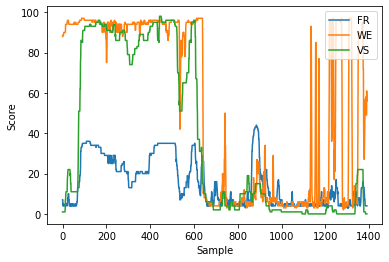

In [8]:
# signals[0] is signal's element 0: bunker
# example from segment #8
# x: time (n seconds), y: bunker in kg/m3

%matplotlib inline

plt.plot(scores[0][test_segment], label='FR')
plt.plot(scores[1][test_segment], label='WE')
plt.plot(scores[2][test_segment], label='VS')
plt.ylabel('Score')
plt.xlabel('Sample')
plt.legend(loc='upper right')
plt.show();

# x: counts, period (time_constant: 60 seconds), stride: 15 seconds (overlap: 60-15 = 45 seconds)
# y: bunker score (maximum is equal to n_class)

In [9]:
%matplotlib ipympl

score = np.array([scores[i][test_segment] for i in range(3)])

fig, axs = plt.subplots(1, 4, figsize=(15,3))
fig.tight_layout()
axs[0].set_title('Fuel Rate (FR) vs n-Sample')
axs[0].set_ylabel('Score')
axs[0].set_ylim((0, n_class))
axs[1].set_title('Wind Effect (WE) vs n-Sample')
axs[1].set_xlabel('n-Sample')
axs[1].set_ylim((0, n_class))
axs[2].set_title('Vessel Speed (VS) vs n-Sample')
axs[2].set_ylim((0, n_class))
plt.xlim((0, score[0].shape[0]))

ax = fig.add_subplot(1, 4, 4, projection='3d')
ax.set_xlim3d([0, n_class])
ax.set_xlabel('FR')
ax.set_ylim3d([0, n_class])
ax.set_ylabel('WE')
ax.set_zlim3d([0, n_class])
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

camera = Camera(fig)
for i in np.linspace(0, score[0].shape[0], 50):
    i = int(i)
    axs[0].plot(score[0,:i], c='r')
    axs[1].plot(score[1,:i], c='g')
    axs[2].plot(score[2,:i], c='b')
    ax.plot(score[0,:i], score[1,:i], score[2,:i], c='k', alpha=0.5, linewidth=1)
    ax.scatter(score[0,:i], score[1,:i], score[2,:i], c='k', s=25, alpha=0.25, edgecolor='white')
    camera.snap()
axs[3].axis('off')

animation = camera.animate()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [10]:
animation.event_source.stop()

In [11]:
# test segment is excluded from HMM (hidden markov model) training
# not included in dataset either, will be later for test

In [12]:
%%time

# bias is for stretching/squeezing a particular axial space 
# to purposefully make points closer or away
# lower is closer
biases = [1, 1, 1]

# create datapoints, and apply bias
b = np.concatenate([score for enum, score in enumerate(scores[0]) if enum != test_segment]) * biases[0]
w = np.concatenate([score for enum, score in enumerate(scores[1]) if enum != test_segment]) * biases[1]
d = np.concatenate([score for enum, score in enumerate(scores[2]) if enum != test_segment]) * biases[2]
datapoints = np.array([b, w, d]).T

Wall time: 2 ms


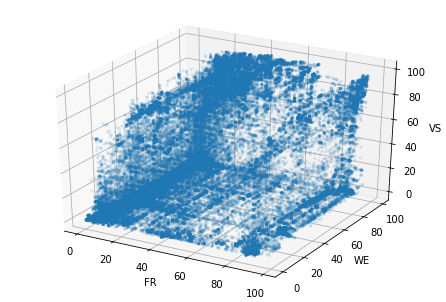

In [13]:
%matplotlib inline

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
plt.show();

In [14]:
n_cluster = 400
infinite_breaker = 500
cluster_quality_thresh = 1
centers = None

In [15]:
# with open('centers_300.pkl', 'rb') as f:
#     centers = pickle.load(f)
# n_cluster = centers.shape[0]
# centers.shape

In [16]:
%%time

# k-means
n_cluster_ = n_cluster
cluster_centers = []
while True:
    if n_cluster_ > infinite_breaker:
        print('optimum not found')
        break
    # create clusters, without noise points
    if centers is not None:
        est = KMeans(n_clusters=n_cluster_, init=centers)
    else:
        est = KMeans(n_clusters=n_cluster_)
    est.fit(datapoints)

    # inverse mean square error
    cluster_quality = [np.linalg.norm(datapoints[est.labels_==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster_)]
    cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])
    # cluster labels accepted
    accepted = cluster_quality >= cluster_quality_thresh
    print(f"n_cluster: {n_cluster_}, minimum: {np.min(cluster_quality)}")
    # accept or exit
    if not np.all(accepted) and centers is None:
        n_cluster_ += 5
        pass
    else:
        break

print('\nnumber of clusters:', est.cluster_centers_.shape[0], '\n')
n_cluster = est.cluster_centers_.shape[0]

n_cluster: 400, minimum: 0.9291308131103162
n_cluster: 405, minimum: 1.0927725061023907

number of clusters: 405 

Wall time: 1min 51s


In [17]:
# with open('centers_300.pkl', 'wb') as f:
#     pickle.dump(est.cluster_centers_, f)
# est.cluster_centers_.shape

number of member of five smallest clusters: 26 28 28 29 33 

largest  cluster: #28, 1665 members
smallest cluster: #372, 26 members


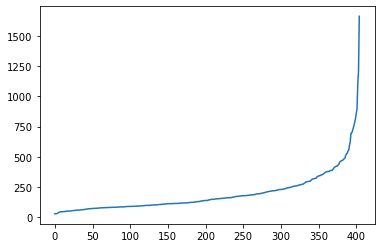

In [18]:
# number of members from each cluster, sorted from low to high
sorted_members = np.array(sorted([est.labels_[est.labels_==i].shape[0] for i in range(np.unique(est.labels_).shape[0])]))
print('number of member of five smallest clusters:', *sorted_members[:5], '\n')
unq, cts = np.unique(est.labels_, return_counts=True)
print('largest  cluster:', f"#{np.where(cts==sorted_members[-1])[0][0]}, {sorted_members[-1]} members")
print('smallest cluster:', f"#{np.where(cts==sorted_members[0])[0][0]}, {sorted_members[0]} members")
plt.plot(sorted_members);

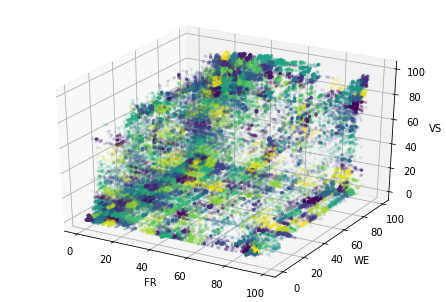

In [19]:
# datapoint_labels = util.associate_to_cluster(datapoints, est.cluster_centers_)
datapoint_labels = est.labels_

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           c=datapoint_labels.astype(float), alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
plt.show();

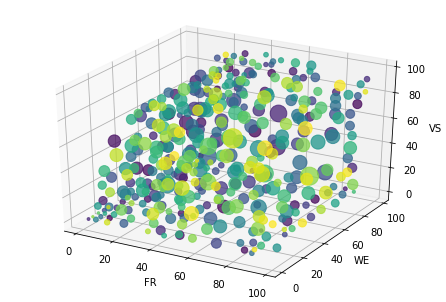

In [20]:
# inverse mean square error
cluster_quality = [np.linalg.norm(datapoints[datapoint_labels==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster)]
cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(est.cluster_centers_[:, 0], est.cluster_centers_[:, 1], est.cluster_centers_[:, 2], 
           c=np.unique(datapoint_labels).astype(float), alpha=0.75, marker='o', 
           s=n_cluster/cluster_quality)
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
# ax.view_init(elev=30, azim=45)
plt.show();

In [21]:
print('lowest quality:', cluster_quality.min())
print('median quality:', np.median(cluster_quality))
print('highest quality:', cluster_quality.max())

lowest quality: 1.0927725061023907
median quality: 4.925129060185334
highest quality: 73.02980545451057


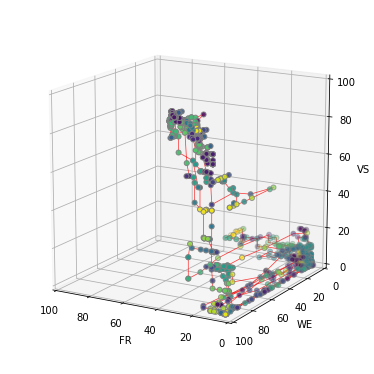

In [22]:
%matplotlib inline

# paint test_segment in cluster label color
ts = np.array([scores[0][test_segment], scores[1][test_segment], scores[2][test_segment]]).T
pred = est.predict(ts)
reassign = dict(zip(set(pred), range(len(set(pred)))))

fig = plt.figure(figsize=(5,5))
fig.size = 12, 12
ax = Axes3D(fig)

bgn, end = 0, ts.shape[0]
end += 1
ax.scatter(scores[0][test_segment][bgn:end], scores[1][test_segment][bgn:end], scores[2][test_segment][bgn:end],
           c=[reassign[lab] for lab in pred][bgn:end], edgecolor='grey', s=25)
ax.plot(scores[0][test_segment][bgn:end], scores[1][test_segment][bgn:end], scores[2][test_segment][bgn:end], 
        c='r', alpha=0.75, linewidth=0.75)

ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_xlim(0, n_class)
ax.set_ylim(0, n_class)
ax.set_zlim(0, n_class)

ax.view_init(azim=120, elev=15)

plt.show();

In [42]:
trace = pd.DataFrame(np.column_stack((pred, ts)), columns=['CN', 'FR', 'WE', 'VS']).iloc[bgn:end].T
trace

,0,1,2,3,4,5,6,7,8,9,...,1381,1382,1383,1384,1385,1386,1387,1388,1389,1390
CN,348,348,157,157,348,348,157,157,157,157,...,260,40,40,40,111,40,40,260,111,40
FR,7,7,4,4,5,5,4,4,4,4,...,7,4,4,4,4,4,4,4,4,4
WE,88,88,88,89,89,89,90,90,90,90,...,47,56,57,50,58,52,57,49,61,56
VS,1,1,1,1,1,1,1,1,1,1,...,1,1,1,0,0,0,0,0,0,0


In [43]:
unq, cts = np.unique(trace.loc['CN'], return_counts=True)
largest = unq[cts==cts.max()][0]
smallest = unq[cts==cts.min()][0]
for_viewing = largest
for_viewing

173

In [25]:
# prepare for training
dataset = util.create_dataset(n_cluster, scores, test_segment, est)

C:\Users\tzy\anaconda3\envs\efficientship\lib\site-packages\ipykernel_launcher.py:23: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


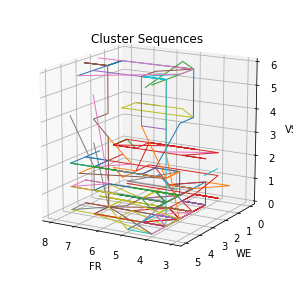

In [26]:
%matplotlib inline

fig, ax = plt.subplots(subplot_kw={'projection': '3d'}, figsize=(5,5))

for clr, trace in enumerate(dataset[for_viewing]):
    # ax.scatter(trace[:,0], trace[:,1], trace[:,2])
    ax.plot(trace[:,0], trace[:,1], trace[:,2], 
            # c='r', 
            alpha=1, linewidth=1)

# ax.set_xlim3d([0, 100])
# ax.set_ylim3d([0, 100])
# ax.set_zlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

ax.set_title(f"Cluster Sequences")
ax.view_init(azim=120, elev=15)

fig.show()

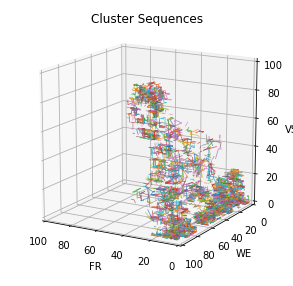

In [27]:
%matplotlib inline

traces_ = [dataset[i] for i in unq]
# colors = ['r', 'g', 'b', 'orange']

fig, ax = plt.subplots(subplot_kw={'projection': '3d'}, figsize=(5,5))

for clr, traces in enumerate(traces_):
    for trace in traces:
        # ax.scatter(trace[:,0], trace[:,1], trace[:,2])
        ax.plot(trace[:,0], trace[:,1], trace[:,2], 
                alpha=0.75, linewidth=0.75)#, c=colors[clr])

ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')

ax.set_xlim(0, n_class)
ax.set_ylim(0, n_class)
ax.set_zlim(0, n_class)

ax.set_title(f"Cluster Sequences")
ax.view_init(azim=120, elev=15)

plt.show();

In [28]:
# 0 bunker, 1 wind effect, 2 distance
hidden_param = 0
observable_param = 1
# hidden: to be predicted
# observable: input
hmm1 = util.hmm_modelling(dataset, n_class, n_cluster, hidden_param, observable_param)

# 0 bunker, 1 wind effect, 2 distance
hidden_param = 0
observable_param = 2
# hidden: to be predicted
# observable: input
hmm2 = util.hmm_modelling(dataset, n_class, n_cluster, hidden_param, observable_param)

In [29]:
%matplotlib ipympl

seqs_0, seqs_1, seqs_2 = [], [], []
for trace in dataset[for_viewing]:
    if trace[:,0].shape[0] < 2 or trace[:,1].shape[0] < 2:
        continue
    seq = list(zip(trace[:-1,0], trace[1:,0]))
    seqs_0.extend(seq)
    seq = list(zip(trace[:-1,1], trace[1:,1]))
    seqs_1.extend(seq)
    seq = list(zip(trace[:-1,2], trace[1:,2]))
    seqs_2.extend(seq)
print(len(seqs_0))

fig, axs = plt.subplots(1, 5, figsize=(18, 4), gridspec_kw={'width_ratios': [5, 1, 1, 5, 5]})
fig.tight_layout()
axs[0].axis(False)
axs[0].set_title('Sequences in Score Space')
axs[1].axes.get_xaxis().set_ticklabels(['', 'A', 'B'])
axs[1].set_ylim([0, 100])
axs[2].axes.get_xaxis().set_visible(False)
axs[2].axes.get_yaxis().set_visible(False)
axs[2].set_ylim([0, 100])
axs[3].set_title('Transition')
axs[3].set_xlabel('FR-B')
axs[3].set_ylabel('FR-A')
axs[3].axes.get_xaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[3].axes.get_yaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[4].set_title('Emission')
axs[4].set_xlabel('FR')
axs[4].set_ylabel('VS')
axs[4].axes.get_xaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[4].axes.get_yaxis().set_ticks([i for i in range(0, n_class, 5)])

ax = fig.add_subplot(1, 4, 1, projection='3d')
ax.set_xlim3d([0, n_class])
ax.set_ylim3d([0, n_class])
ax.set_zlim3d([0, n_class])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
# ax.view_init(15, 105)

grid_tr = np.zeros((n_class, n_class))
grid_em = np.zeros((n_class, n_class))

camera = Camera(fig)
ss = []
for seq_0, seq_1, seq_2 in tqdm(zip(seqs_0, seqs_1, seqs_2), total=len(seqs_0)):
    axs[1].plot(seq_0, c='k', alpha=0.25, linewidth=1)
    ss.append(seq_0)
    grid_tr[seq_0[1], seq_0[0]] = grid_tr[seq_0[1], seq_0[0]]  + 1
    grid_em[seq_2[0], seq_0[0]] = grid_em[seq_2[0], seq_0[0]]  + 1
    grid_em[seq_2[1], seq_0[1]] = grid_em[seq_2[1], seq_0[1]]  + 1
    for s in ss:
        axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
    ax.plot(seq_0, seq_1, seq_2, c='r', linewidth=3)
    ax.scatter(seq_0, seq_1, seq_2, c='r', s=25)
    ax.text(seq_0[0], seq_1[0], seq_2[0], 'A', ha='right', va='top')
    ax.text(seq_0[1], seq_1[1], seq_2[1], 'B', ha='left', va='bottom')
    axs[3].imshow(grid_tr, cmap='gray')
    axs[4].imshow(grid_em, cmap='gray')
    camera.snap()

animation = camera.animate()

for trace in dataset[for_viewing]:
    ax.plot(trace[:,0], trace[:,1], trace[:,2], c='k', alpha=0.25, linewidth=1)

694


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

100%|██████████| 694/694 [01:38<00:00,  7.04it/s]


In [30]:
# animation.save('test.gif', fps=5) # writer='imagemagick'
animation.event_source.stop()

In [31]:
# prediction
sigma = 1

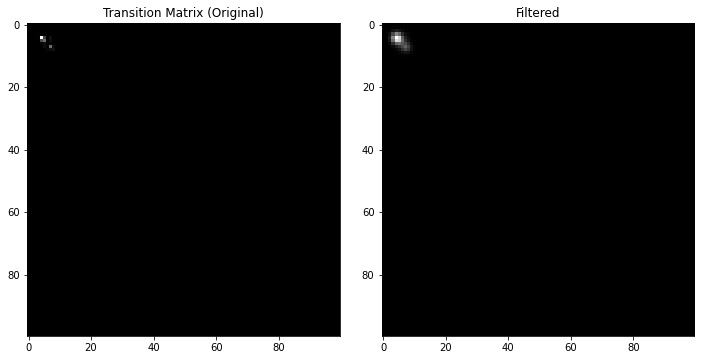

In [32]:
%matplotlib inline

from scipy.ndimage import gaussian_filter

fig, axs = plt.subplots(1, 2, figsize=(10, 5), gridspec_kw={'width_ratios': [1, 1]})
fig.tight_layout()

axs[0].set_title('Transition Matrix (Original)')
axs[0].imshow(grid_tr, cmap='gray')
axs[1].set_title('Filtered')
axs[1].imshow(gaussian_filter(grid_tr, sigma=1), cmap='gray')

plt.show()

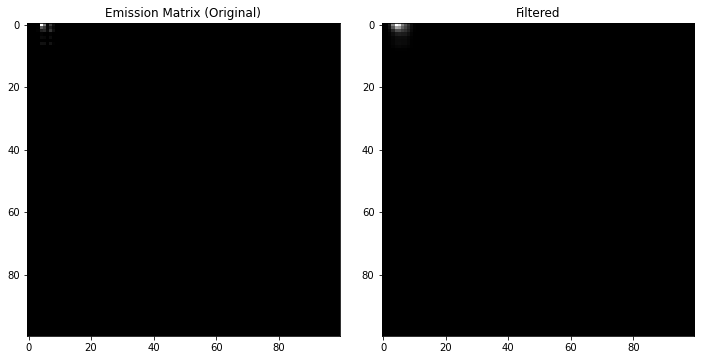

In [33]:
%matplotlib inline

from scipy.ndimage import gaussian_filter

fig, axs = plt.subplots(1, 2, figsize=(10, 5), gridspec_kw={'width_ratios': [1, 1]})
fig.tight_layout()

axs[0].set_title('Emission Matrix (Original)')
axs[0].imshow(grid_em, cmap='gray')
axs[1].set_title('Filtered')
axs[1].imshow(gaussian_filter(grid_em, sigma=1), cmap='gray')

plt.show()

In [34]:
cluster_member_1, path1 = util.predict(scores, test_segment, est, hmm1, sigma)
cluster_member_2, path2 = util.predict(scores, test_segment, est, hmm2, sigma)

In [35]:
# test_segment's score
score = np.array([scores[i][test_segment] for i in range(3)])


AUC (area under curve) difference from ground truth : -32.2 %
MSE (mean squared error) from ground truth          : 108


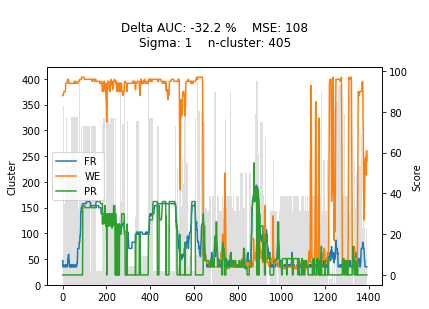

In [36]:
hidden_param = 0
observable_param = 1

if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member_1)), cluster_member_1, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='WE');
plt.xlabel('Sample')
plt.plot(path1, label='PR');
plt.legend(loc='best');

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path1)), path1)
auc_diff = (auc_pred - auc_truth) / auc_truth

title_1 = '\nAUC (area under curve) difference from ground truth : {:.1f} %'.format(100 * auc_diff)
title_2 = f"MSE (mean squared error) from ground truth          : {round(mean_squared_error(score[hidden_param], path1))}"
print(title_1)
print(title_2)

plt.title('\nDelta AUC: {:.1f} %'.format(100 * auc_diff) + 
          '    ' + 
          'MSE: {}'.format(round(mean_squared_error(score[hidden_param], path1))) + 
          '\n' +
          f'Sigma: {sigma}' +
          '    '  +
          f'n-cluster: {n_cluster}' +
          '\n')

plt.show();


AUC (area under curve) difference from ground truth : 4.5 %
MSE (mean squared error) from ground truth          : 11


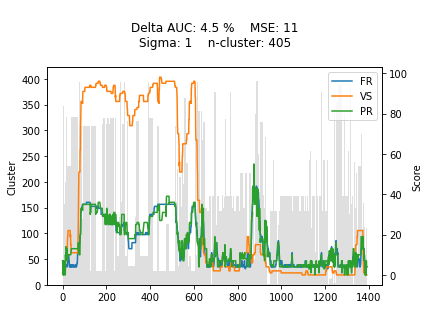

In [37]:
hidden_param = 0
observable_param = 2

if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member_2)), cluster_member_2, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='VS');
plt.plot(path2, label='PR');
plt.xlabel('Sample')
plt.legend(loc='best');

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path2)), path2)
auc_diff = (auc_pred - auc_truth) / auc_truth

title_1 = '\nAUC (area under curve) difference from ground truth : {:.1f} %'.format(100 * auc_diff)
title_2 = f"MSE (mean squared error) from ground truth          : {round(mean_squared_error(score[hidden_param], path2))}"
print(title_1)
print(title_2)

plt.title('\nDelta AUC: {:.1f} %'.format(100 * auc_diff) + 
          '    ' + 
          'MSE: {}'.format(round(mean_squared_error(score[hidden_param], path2))) + 
          '\n' +
          f'Sigma: {sigma}' +
          '    '  +
          f'n-cluster: {n_cluster}' +
          '\n')

plt.show();

In [38]:
with open('accuracy.pkl', 'rb') as f:
    acc = pickle.load(f)

In [39]:
best = sorted([[i, mse] for i, (auc, mse) in enumerate(acc)], key=itemgetter(1))[8][0]
print(best, *acc[best])

83 -0.01746545559957484 11.808770668583753
